## Air ECG 模型训练

# step1 数据加载

In [1]:
import scipy
import math
import random
import argparse
from time import time
import sys
from pathlib import Path
from typing import Iterable, Optional
import numpy as np
import torch
import torch.multiprocessing
torch.multiprocessing.set_sharing_strategy('file_system')
import torch.nn as nn
from torch.utils.tensorboard import SummaryWriter
import misc
from misc import NativeScalerWithGradNormCount as NativeScaler
import pickle
import neurokit2 as nk
import matplotlib
import os
import torch
import scipy.io as sio
from torch.nn.utils.parametrizations import weight_norm
from torch.utils.data import TensorDataset, DataLoader
from einops import rearrange, repeat
from einops.layers.torch import Rearrange
import time
import torch.optim as optim

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
data = pickle.load(open(r'D:\pyccode\mmWave\ECG\training\matched_1723609564.3745.pkl.pkl', 'rb'))

In [2]:
data

{'RCG': array([[-8.20958284e+01, -6.33394718e+01, -1.30293429e+02, ...,
         -4.12595396e+01, -1.31630328e+02, -1.55625764e+02],
        [-7.61087905e+00, -3.10513377e+01, -1.02573765e+02, ...,
          7.42700330e+00, -1.48121867e+02, -1.23775165e+02],
        [ 5.11861840e+01,  4.88966703e+00, -4.83103393e+01, ...,
          4.46209801e+01, -7.81926226e+00, -2.96921857e+01],
        ...,
        [-1.84710458e+02, -3.58270556e+02, -1.29523072e+01, ...,
         -5.69387949e+02,  8.44881187e+01, -6.64064540e+01],
        [-1.87125798e+01,  5.78165054e-02,  4.18588312e+01, ...,
         -1.34686445e+02, -1.69770641e+02,  5.80429863e+01],
        [ 1.22754075e+02,  2.27358490e+02,  6.49663494e+01, ...,
          3.42379173e+02, -8.11084784e+01,  1.34311753e+02]]),
 'ECG': array([ 0.97104365,  1.21279598,  1.46853825, ..., -0.3634016 ,
        -0.37693514, -0.40415283]),
 'pozXYZ': array([[ 4.,  2.,  7.],
        [ 4.,  2., 13.],
        [ 4.,  3.,  6.],
        [ 3.,  3.,  7.],
    

In [3]:
print(data.keys())

dict_keys(['RCG', 'ECG', 'pozXYZ'])


In [4]:
def min_max_normalization(data):
    min_val = np.min(data, axis=(0, 1), keepdims=True)
    max_val = np.max(data, axis=(0, 1), keepdims=True)
    normalized_data = (data - min_val) / (max_val - min_val)
    return normalized_data


def sliding_window_sampling(time_series, sample_size, step):
    num_samples = (time_series.shape[1] - sample_size) // step + 1
    samples = [time_series[:, i * step : i * step + sample_size] for i in range(num_samples)]
    return np.array(samples)
rcg_signal = data['RCG']
ecg_signal = data['ECG']
position = data['pozXYZ']
#print(rcg_signal.shape, ecg_signal.shape, position.shape)
rcg_data = min_max_normalization(rcg_signal)
RCG_segmented = sliding_window_sampling(np.transpose(rcg_data), 640, 30)
rcg_data.shape, RCG_segmented.shape
#RCG_segmented = np.expand_dims(RCG_segmented, axis=2)  # 增加一个维度

((36000, 50), (1179, 50, 640))

In [5]:
ecg_clean = nk.ecg_clean(ecg_signal, sampling_rate=200)
ecg_clean.shape

(36000,)

In [6]:
position

array([[ 4.,  2.,  7.],
       [ 4.,  2., 13.],
       [ 4.,  3.,  6.],
       [ 3.,  3.,  7.],
       [ 3.,  8., 10.],
       [ 3.,  4.,  8.],
       [ 4.,  5.,  4.],
       [ 2.,  2.,  7.],
       [ 4.,  3.,  9.],
       [ 5.,  4., 10.],
       [ 3.,  5.,  5.],
       [ 3.,  2., 15.],
       [ 4.,  3.,  8.],
       [ 3.,  3.,  8.],
       [ 4.,  2., 10.],
       [ 4.,  6.,  7.],
       [ 4.,  3.,  7.],
       [ 2.,  4.,  9.],
       [ 7.,  1., 10.],
       [ 3.,  7.,  9.],
       [ 4.,  4.,  5.],
       [ 4.,  7., 12.],
       [ 5.,  3.,  7.],
       [ 3.,  2., 10.],
       [ 3.,  5.,  6.],
       [ 4.,  3.,  9.],
       [ 5.,  2.,  7.],
       [ 0.,  0.,  8.],
       [ 5.,  2.,  9.],
       [ 4.,  2., 15.],
       [ 2.,  1.,  2.],
       [ 3.,  3.,  4.],
       [ 3.,  5.,  7.],
       [ 4.,  2.,  0.],
       [ 4.,  2.,  7.],
       [ 3.,  8.,  7.],
       [ 3.,  4.,  9.],
       [ 4.,  2.,  6.],
       [ 4.,  3.,  7.],
       [ 5.,  8.,  7.],
       [ 4.,  3.,  8.],
       [ 6.,  4.

In [7]:


# 体素网格的维度
voxel_grid_dimensions = (9, 9, 17)

# 体素范围
voxel_range = {
    "x": (-0.4, 0.4),
    "y": (0.35, 0.6),
    "z": (-0.4, 0.4),
}

# 体素步长计算
voxel_step = {
    "x": (voxel_range["x"][1] - voxel_range["x"][0]) / (voxel_grid_dimensions[0] - 1),
    "y": (voxel_range["y"][1] - voxel_range["y"][0]) / (voxel_grid_dimensions[1] - 1),
    "z": (voxel_range["z"][1] - voxel_range["z"][0]) / (voxel_grid_dimensions[2] - 1),
}

# 示例的索引数组
index_array = position
# 计算真实空间坐标
voxel_positions_real = np.zeros_like(index_array)

voxel_positions_real[:, 0] = voxel_range["x"][0] + index_array[:, 0] * voxel_step["x"]
voxel_positions_real[:, 1] = voxel_range["y"][0] + index_array[:, 1] * voxel_step["y"]
voxel_positions_real[:, 2] = voxel_range["z"][0] + index_array[:, 2] * voxel_step["z"]

print(voxel_positions_real)


[[ 0.       0.4125  -0.05   ]
 [ 0.       0.4125   0.25   ]
 [ 0.       0.44375 -0.1    ]
 [-0.1      0.44375 -0.05   ]
 [-0.1      0.6      0.1    ]
 [-0.1      0.475    0.     ]
 [ 0.       0.50625 -0.2    ]
 [-0.2      0.4125  -0.05   ]
 [ 0.       0.44375  0.05   ]
 [ 0.1      0.475    0.1    ]
 [-0.1      0.50625 -0.15   ]
 [-0.1      0.4125   0.35   ]
 [ 0.       0.44375  0.     ]
 [-0.1      0.44375  0.     ]
 [ 0.       0.4125   0.1    ]
 [ 0.       0.5375  -0.05   ]
 [ 0.       0.44375 -0.05   ]
 [-0.2      0.475    0.05   ]
 [ 0.3      0.38125  0.1    ]
 [-0.1      0.56875  0.05   ]
 [ 0.       0.475   -0.15   ]
 [ 0.       0.56875  0.2    ]
 [ 0.1      0.44375 -0.05   ]
 [-0.1      0.4125   0.1    ]
 [-0.1      0.50625 -0.1    ]
 [ 0.       0.44375  0.05   ]
 [ 0.1      0.4125  -0.05   ]
 [-0.4      0.35     0.     ]
 [ 0.1      0.4125   0.05   ]
 [ 0.       0.4125   0.35   ]
 [-0.2      0.38125 -0.3    ]
 [-0.1      0.44375 -0.2    ]
 [-0.1      0.50625 -0.05   ]
 [ 0.     

In [8]:

mat_data = scipy.io.loadmat('../trainALL/1.mat')
data = mat_data['data']
print(data[0][0][0].shape, data[0][0][1].shape, data[0][0][2].shape)


(35505, 50) (35505, 1) (50, 3)


In [9]:
np.max(data[0][0][1]) - np.min(data[0][0][1])

np.float64(0.9249045380086351)

In [10]:
print(ecg_clean.shape, rcg_signal.shape, position.shape)

(36000,) (36000, 50) (50, 3)


# Step2 数据预处理

In [3]:


# 体素网格的维度和范围
voxel_grid_dimensions = (9, 9, 17)
voxel_range = {
    "x": (-0.4, 0.4),
    "y": (0.35, 0.6),
    "z": (-0.4, 0.4),
}
# 体素步长计算
voxel_step = {
    "x": (voxel_range["x"][1] - voxel_range["x"][0]) / (voxel_grid_dimensions[0] - 1),
    "y": (voxel_range["y"][1] - voxel_range["y"][0]) / (voxel_grid_dimensions[1] - 1),
    "z": (voxel_range["z"][1] - voxel_range["z"][0]) / (voxel_grid_dimensions[2] - 1),
}

# 定义数据加载和预处理函数
def load_files(directory):
    """
    从指定的文件夹中加载所有的 .pkl 文件。
    返回加载后的数据字典列表。
    """
    data_list = []
    
    # 遍历文件夹中的所有文件
    for file_name in os.listdir(directory):
        if file_name.endswith('.mat'):
            file_path = os.path.join(directory, file_name)
            # 使用 pickle 加载 .pkl 文件
            with open(file_path, 'rb') as f:
                data = sio.loadmat(f)
                data = data['data']
                data_list.append(data)
    
    return data_list

# def quantization(data, num_levels=256):
#     norm = (data - np.min(data)) / (np.max(data) - np.min(data))
#     quantized_data = np.round(norm * (num_levels - 1))
#     return quantized_data

def min_max_normalization(data):
    min_val = np.min(data, axis=(0, 1), keepdims=True)
    max_val = np.max(data, axis=(0, 1), keepdims=True)
    normalized_data = (data - min_val) / (max_val - min_val)
    normalized_data = normalized_data * 2 - 1
    return normalized_data

def min_max_normalization_ecg(data):
    min_val = np.min(data)
    max_val = np.max(data)
    normalized_data = (data - min_val) / (max_val - min_val)
    normalized_data = normalized_data * 2 - 1
    return normalized_data


def sliding_window_sampling(time_series, sample_size, step):
    num_samples = (time_series.shape[1] - sample_size) // step + 1
    samples = [time_series[:, i * step : i * step + sample_size] for i in range(num_samples)]
    return np.array(samples)

def sliding_window_sampling1d(time_series, sample_size, step):
    num_samples = (len(time_series) - sample_size) // step + 1
    samples = [time_series[i * step : i * step + sample_size] for i in range(num_samples)]
    return np.array(samples)

def restore_real_coordinates(index_array):
    """
    将 pozXYZ 的体素网格索引转换为真实的物理坐标。
    """
    voxel_positions_real = np.zeros_like(index_array)

    voxel_positions_real[:, 0] = voxel_range["x"][0] + index_array[:, 0] * voxel_step["x"]
    voxel_positions_real[:, 1] = voxel_range["y"][0] + index_array[:, 1] * voxel_step["y"]
    voxel_positions_real[:, 2] = voxel_range["z"][0] + index_array[:, 2] * voxel_step["z"]
    
    return voxel_positions_real

def preprocess_data(data_dict, rcg_sample_size=640, ecg_sample_size=640, step=30, sampling_rate=200):
    """
    对单个数据字典进行预处理。
    """
    # 处理 RCG 数据
    rcg_data = data_dict[0][0][0].astype(np.float32)
    rcg_data = min_max_normalization(rcg_data)
    RCG_segmented = sliding_window_sampling(np.transpose(rcg_data), rcg_sample_size, step)
    RCG_segmented = np.expand_dims(RCG_segmented, axis=2)  # 增加一个维度

    # 处理 ECG 数据
    ecg_data = data_dict[0][0][1].astype(np.float32)
    # 使用 neurokit2 进行 ECG 信号清理
    ecg_clean = nk.ecg_clean(ecg_data, sampling_rate=sampling_rate)
    
    
    # 量化清理后的 ECG 数据
    #ECG_quantized = quantization(ecg_clean)
    ecg_norm = min_max_normalization_ecg(ecg_clean)
    ECG_segmented = sliding_window_sampling1d(ecg_norm, ecg_sample_size, step)

    # 还原 pozXYZ 的真实坐标
    pozXYZ_data = data_dict[0][0][2].astype(np.float32)
    pozXYZ_real = restore_real_coordinates(pozXYZ_data)  

    # 确保 pozXYZ 的重复次数与 ECG_segmented 的第一维度匹配
    num_segments = ECG_segmented.shape[0]
    pozXYZ_repeated = np.tile(pozXYZ_real, (num_segments, 1, 1))

    return RCG_segmented, ECG_segmented, pozXYZ_repeated

# 主函数：加载所有文件并预处理
def Preprocessing(directory, sampling_rate=200):
    """
    加载目录下的所有 .pkl 文件，并对其进行预处理。
    返回预处理后的 RCG、ECG 和 pozXYZ 数据列表。
    """
    # 加载所有 .pkl 文件
    all_data = load_files(directory)
    
    # 初始化空列表，用于存储处理后的数据
    all_RCG = []
    all_ECG = []
    all_pozXYZ = []

    # 对每个数据字典进行预处理
    for data_dict in all_data:
        RCG_segmented, ECG_segmented, pozXYZ_segmented = preprocess_data(data_dict, sampling_rate=sampling_rate)
        
        # 展开并拼接结果
        all_RCG.append(RCG_segmented)
        all_ECG.append(ECG_segmented)
        all_pozXYZ.append(pozXYZ_segmented)

    # 将所有文件处理后的结果拼接成统一的数组
    all_RCG = np.concatenate(all_RCG, axis=0)
    all_ECG = np.concatenate(all_ECG, axis=0)
    all_pozXYZ = np.concatenate(all_pozXYZ, axis=0)

    return all_RCG, all_ECG, torch.tensor(all_pozXYZ, dtype=torch.float32)




# Step3 创建数据集

In [4]:
def build_dataset(is_train, args):
    path = os.path.join(args.root_path, 'training' if is_train else 'testing')
    RCG, ECG, pozXYZ = Preprocessing(path)
    # 打印处理后的形状
    if is_train:
        print("Training RCG shape:", RCG.shape) 
        print("Training ECG shape:", ECG.shape)  
        print("Training pozXYZ shape:", pozXYZ.shape)
    else:
        print("Testing RCG shape:", RCG.shape) 
        print("Testing ECG shape:", ECG.shape)  
        print("Testing pozXYZ shape:", pozXYZ.shape)
    dataset = TensorDataset(torch.tensor(RCG, dtype=torch.float32), pozXYZ, torch.tensor(ECG, dtype=torch.float32))

    return dataset


# Step4 构建Parser


In [5]:
def get_args_parser():
    parser = argparse.ArgumentParser('AirECG Training', add_help=False)
    
    # Training parameters
    parser.add_argument('--batch_size', default=64, type=int, 
                        help='Batch size per GPU (effective batch size is batch_size * accum_iter * # gpus)')
    parser.add_argument('--epochs', default=100, type=int)
    parser.add_argument('--accum_iter', default=1, type=int, 
                        help='Accumulate gradient iterations (for increasing the effective batch size under memory constraints)')

    # Optimizer parameters
    parser.add_argument('--weight_decay', type=float, default=0.0001, 
                        help='weight decay (default: 0.0001)')
    parser.add_argument('--lr', type=float, default=0.001, metavar='LR', 
                        help='learning rate (absolute lr)')
    parser.add_argument('--lr_scheduler', type=str, default='cosine', help='lr scheduler (default: cosine)')
    
    # Path parameters
    parser.add_argument('--root_path', default=r'D:\pyccode\mmWave\ECG\trainAll', 
                        help='path where to save, empty for no saving')
    parser.add_argument('--output_dir', default='./output_dir_pretrained', 
                        help='path where to save, empty for no saving')
    parser.add_argument('--log_dir', default='./output_dir_pretrained', 
                        help='path where to tensorboard log')

    # Resume training
    parser.add_argument('--resume', default=r'', 
                        help='resume from checkpoint')

    # Miscellaneous
    parser.add_argument('--start_epoch', default=0, type=int, metavar='N', 
                        help='start epoch')
    parser.add_argument('--num_workers', default=16, type=int)
    parser.add_argument('--pin_mem', action='store_true', 
                        help='Pin CPU memory in DataLoader for more efficient (sometimes) transfer to GPU.')
    parser.add_argument('--no_pin_mem', action='store_false', dest="pin_mem")
    
    parser.set_defaults(pin_mem=True)
    
    return parser

# Step 5 训练函数

In [6]:
# #速度慢
# def train_one_epoch(model: torch.nn.Module, criterion: torch.nn.Module,
#                     data_loader: Iterable, optimizer: torch.optim.Optimizer,
#                     device: torch.device, epoch: int, loss_scaler, max_norm: float = 0,
#                     log_writer=None, args=None):
    
#     model.train(True)
#     print_freq = 2
#     accum_iter = args.accum_iter

#     if log_writer is not None:
#         print('log_dir: {}'.format(log_writer.log_dir))



#     for data_iter_step, [inputs, posXYZ_tensor, labels] in enumerate(data_loader, 0):

#         start_time = time.perf_counter()
#         inputs = inputs.to(device, non_blocking=True)
#         posXYZ_tensor = posXYZ_tensor.to(device, non_blocking=True)
#         labels = labels.to(device, non_blocking=True)
#         load_data_time = time.perf_counter() - start_time

#         start_time = time.perf_counter()
#         outputs = model(inputs, posXYZ_tensor)
#         model_process_time = time.perf_counter() - start_time

#         # Warmup learning rate
#         warmup_lr = args.lr
#         optimizer.param_groups[0]["lr"] = warmup_lr
#         start_time = time.perf_counter()
#         loss = criterion(outputs, labels.long())
#         loss /= accum_iter

#         loss_scaler(loss, optimizer, clip_grad=max_norm,
#                     parameters=model.parameters(), create_graph=False,
#                     update_grad=(data_iter_step + 1) % accum_iter == 0)

#         loss_value = loss.item()

#         if (data_iter_step + 1) % accum_iter == 0:
#             optimizer.zero_grad()
#         backward_time = time.perf_counter() - start_time

#         if not math.isfinite(loss_value):
#             print("Loss is {}, stopping training".format(loss_value))
#             sys.exit(1)
        
#         print(f"Load data time: {load_data_time:.4f}, Model process time: {model_process_time:.4f}, "
#               f"Backward time: {backward_time:.4f}")

    

#         if log_writer is not None and (data_iter_step + 1) % accum_iter == 0:
#             epoch_1000x = int((data_iter_step / len(data_loader) + epoch) * 1000)
#             log_writer.add_scalar('loss', loss_value, epoch_1000x)
#             log_writer.add_scalar('lr', warmup_lr, epoch_1000x)
#             print(f"Epoch: {epoch}, Step: {data_iter_step}, Loss: {loss_value}, LR: {warmup_lr}")

In [7]:

from torch.amp import autocast, GradScaler

def train_one_epoch(model: torch.nn.Module, criterion: torch.nn.Module,
                    data_loader: Iterable, optimizer: torch.optim.Optimizer,
                    device: torch.device, epoch: int, loss_scaler, max_norm: float = 0,
                    log_writer=None, args=None):

    model.train(True)
    print_freq = 2
    scaler = GradScaler()  # 使用 GradScaler 进行混合精度训练


    if log_writer is not None:
        print('log_dir: {}'.format(log_writer.log_dir))
    
    history_ecg = None

    for data_iter_step, [inputs, posXYZ_tensor, labels] in enumerate(data_loader, 0):
        if history_ecg is None:
            batch_size = inputs.size(0)
            history_ecg = torch.zeros((batch_size, 640), device=device)
        # 数据加载
        start_time = time.perf_counter()
        inputs = inputs.to(device, non_blocking=True)
        posXYZ_tensor = posXYZ_tensor.to(device, non_blocking=True)
        labels = labels.to(device, non_blocking=True)
        load_data_time = time.perf_counter() - start_time

        # 前向传播和损失计算
        start_time = time.perf_counter()
        with autocast(device_type='cuda', dtype=torch.float16):  # 使用混合精度
            outputs = model(inputs, posXYZ_tensor, history_ecg).flatten(1)
            #outputs = model(inputs)
            loss = criterion(outputs, labels.float())
        model_process_time = time.perf_counter() - start_time

        # 反向传播和参数更新
        start_time = time.perf_counter()
        scaler.scale(loss).backward()  # 缩放损失并进行反向传播

        # 梯度裁剪（如果需要）
        if max_norm > 0:
            scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)

        scaler.step(optimizer)  # 更新模型参数
        scaler.update()  # 更新缩放因子
        optimizer.zero_grad()  # 清除梯度缓存
        backward_time = time.perf_counter() - start_time

        history_ecg = outputs.detach()

        # 输出时间信息
        print(f"Load data time: {load_data_time:.4f}, Model process time: {model_process_time:.4f}, "
              f"Backward time: {backward_time:.4f}")

        # 记录日志
        if log_writer is not None:
            epoch_1000x = int((data_iter_step / len(data_loader) + epoch) * 1000)
            log_writer.add_scalar('loss', loss.item(), epoch_1000x)
            log_writer.add_scalar('lr', optimizer.param_groups[0]["lr"], epoch_1000x)
            print(f"Epoch: {epoch}, Step: {data_iter_step}, Loss: {loss.item()}, LR: {optimizer.param_groups[0]['lr']}")


# Step6 评估函数

In [8]:


@torch.no_grad()
def evaluate(data_loader, model, device):
    criterion = torch.nn.MSELoss()  

    metric_logger = misc.MetricLogger(delimiter=" ")
    header = 'Test:'

    # 切换到评估模式
    model = model.to(device)
    model.eval()

    # 累积损失
    accumulate_loss = 0

    history_ecg = None

    for i, batch in enumerate(metric_logger.log_every(data_loader, 10, header)):

        # 假设 batch 包含 inputs、posXYZ_tensor、labels
        inputs = batch[0].to(device, non_blocking=True)
        posXYZ_tensor = batch[1].to(device, non_blocking=True)
        labels = batch[2].to(device, non_blocking=True)
        
        if history_ecg is None:
            batch_size = inputs.size(0)
            history_ecg = torch.zeros((batch_size, 640), device=device)

        # 计算输出
        outputs = model(inputs, posXYZ_tensor, history_ecg).flatten(1)
        #outputs = model(inputs)
        loss = criterion(outputs, labels.float())

        # 累积损失
        accumulate_loss += loss.item()

        # 更新损失记录
        metric_logger.update(loss=loss.item())

        history_ecg = outputs.detach()

    # 在所有进程之间同步统计信息（如果使用分布式训练）
    metric_logger.synchronize_between_processes()

    # 输出最终的平均损失
    print(f'* Loss {metric_logger.loss.global_avg:.3f}')

    return {k: meter.global_avg for k, meter in metric_logger.meters.items()}


# Step6 构建模型

In [9]:
# ##########yin############
# ############CNN#############
# class ConvLayer(nn.Module):
#     def __init__(self):
#         super(ConvLayer, self).__init__()

#         self.conv1 = self._make_layers(1, 8, 8, pool=False)
#         self.conv2 = self._make_layers(8, 16, 2)
#         self.conv3 = self._make_layers(16, 24, 1.5)
#         self.conv4 = self._make_layers(24, 32, 1)

#     def _make_layers(self, input_features, output_features, mul, pool=True):
#         mid = int(input_features * mul)
#         if pool:
#             return nn.Sequential(
#                 nn.Conv1d(
#                     in_channels = input_features
#                     , out_channels = mid
#                     , kernel_size = 7 
#                     , padding = 3 
#                 )
#                 , nn.ReLU()
#                 , nn.BatchNorm1d(mid)
#                 , nn.Conv1d(
#                     in_channels = mid
#                     , out_channels = output_features
#                     , kernel_size = 7 
#                     , padding = 3 
#                 )
#                 , nn.ReLU()
#                 , nn.BatchNorm1d(output_features)
#                 , nn.MaxPool1d(kernel_size = 2, stride = 2)
#             )
#         else:
#             return nn.Sequential(
#                 nn.Conv1d(
#                     in_channels = input_features
#                     , out_channels = mid
#                     , kernel_size = 7 
#                     , padding = 3 
#                 )
#                 , nn.ReLU()
#                 , nn.BatchNorm1d(mid)
#                 , nn.Conv1d(
#                     in_channels = mid
#                     , out_channels = output_features
#                     , kernel_size = 7 
#                     , padding = 3 
#                 )
#                 , nn.ReLU()
#                 , nn.BatchNorm1d(output_features))
        
#     def forward(self, x):
#         x = self.conv1(x)
#         x = self.conv2(x)
#         x = self.conv3(x)
#         x = self.conv4(x)
#         return x

# class DeconvLayer(nn.Module):
#     def __init__(self):
#         super(DeconvLayer, self).__init__()

#         self.conv1 = self._make_layers(32, 32)
#         self.conv2 = self._make_layers(32, 16)
#         self.conv3 = self._make_layers(16, 8)
#         self.conv4 = self._make_layers(8, 4, deconv=False)

#     def _make_layers(self, input_features, output_features, deconv=True):
#         if deconv:
#             return nn.Sequential(
#                 nn.ConvTranspose1d(
#                     in_channels = input_features
#                     , out_channels = input_features
#                     , kernel_size = 2
#                     , stride = 2
#                 )
#                 , nn.Conv1d(
#                     in_channels = input_features
#                     , out_channels = output_features
#                     , kernel_size = 7
#                     , padding = 3
#                 )
#                 , nn.Conv1d(
#                     in_channels = output_features
#                     , out_channels = output_features
#                     , kernel_size = 7
#                     , padding = 3 
#                 )
#             )
#         else:
#             return nn.Sequential(
#                 nn.Conv1d(
#                     in_channels = input_features
#                     , out_channels = output_features
#                     , kernel_size = 7
#                     , padding = 3
#                 )
#                 , nn.Conv1d(
#                     in_channels = output_features
#                     , out_channels = output_features
#                     , kernel_size = 7
#                     , padding = 3 
#                 )
#             )
        
#     def forward(self, x):
#         x = self.conv1(x)
#         x = self.conv2(x)
#         x = self.conv3(x)
#         x = self.conv4(x)
#         return x

# ############transformer##############
# class FeedForward(nn.Module):
#     def __init__(self, dim, hidden_dim, dropout = 0.):
#         super().__init__()
#         self.net = nn.Sequential(
#             nn.LayerNorm(dim),
#             nn.Linear(dim, hidden_dim),
#             nn.GELU(),
#             nn.Dropout(dropout),
#             nn.Linear(hidden_dim, dim),
#             nn.Dropout(dropout)
#         )
#     def forward(self, x):
#         return self.net(x)

# class Attention(nn.Module):
#     def __init__(self, dim, heads = 8, dim_head = 64, dropout = 0.):
#         super().__init__()
#         inner_dim = dim_head *  heads
#         project_out = not (heads == 1 and dim_head == dim)

#         self.heads = heads
#         self.scale = dim_head ** -0.5

#         self.norm = nn.LayerNorm(dim)
#         self.attend = nn.Softmax(dim = -1)
#         self.dropout = nn.Dropout(dropout)

#         self.to_qkv = nn.Linear(dim, inner_dim * 3, bias = False)

#         self.to_out = nn.Sequential(
#             nn.Linear(inner_dim, dim),
#             nn.Dropout(dropout)
#         ) if project_out else nn.Identity()

#     def forward(self, x):
#         x = self.norm(x)
#         qkv = self.to_qkv(x).chunk(3, dim = -1)
#         q, k, v = map(lambda t: rearrange(t, 'b n (h d) -> b h n d', h = self.heads), qkv)

#         dots = torch.matmul(q, k.transpose(-1, -2)) * self.scale

#         attn = self.attend(dots)
#         attn = self.dropout(attn)

#         out = torch.matmul(attn, v)
#         out = rearrange(out, 'b h n d -> b n (h d)')
#         return self.to_out(out)

# class Transformer(nn.Module):
#     def __init__(self, dim, depth, heads, dim_head, mlp_dim, dropout = 0.):
#         super().__init__()
#         self.layers = nn.ModuleList([])
#         for _ in range(depth):
#             self.layers.append(nn.ModuleList([
#                 Attention(dim, heads = heads, dim_head = dim_head, dropout = dropout),
#                 FeedForward(dim, mlp_dim, dropout = dropout)
#             ]))
#     def forward(self, x):
#         for attn, ff in self.layers:
#             x = attn(x) + x
#             x = ff(x) + x
#         return x

# ##########TCN################
# class Chomp1d(nn.Module):
#     def __init__(self, chomp_size):
#         super(Chomp1d, self).__init__()
#         self.chomp_size = chomp_size

#     def forward(self, x):
#         return x[:, :, :-self.chomp_size].contiguous()
#         # return x[:, :-self.chomp_size].contiguous()


# class TemporalBlock(nn.Module):
#     def __init__(
#             self
#             , n_inputs, n_outputs, kernel_size
#             , stride, dilation, padding, dropout = 0.2
#     ):
#         super(TemporalBlock, self).__init__()
#         self.conv1 = weight_norm(nn.Conv1d(
#             n_inputs, n_outputs, kernel_size,
#             stride = stride, padding = padding, dilation = dilation
#         ))
#         self.chomp1 = Chomp1d(padding)
#         self.relu1 = nn.ReLU()
#         self.dropout1 = nn.Dropout(dropout)

#         self.conv2 = weight_norm(nn.Conv1d(
#             n_outputs, n_outputs, kernel_size,
#             stride = stride, padding = padding, dilation = dilation
#         ))
#         self.chomp2 = Chomp1d(padding)
#         self.relu2 = nn.ReLU()
#         self.dropout2 = nn.Dropout(dropout)

#         self.net = nn.Sequential(
#             self.conv1, self.chomp1, self.relu1, self.dropout1,
#             self.conv2, self.chomp2, self.relu2, self.dropout2
#         )
#         self.downsample = nn.Conv1d(n_inputs, n_outputs, 1) if n_inputs != n_outputs else None
#         self.relu = nn.ReLU()
#         self.init_weights()

#     def init_weights(self):
#         self.conv1.weight.data.normal_(0, 0.01)
#         self.conv2.weight.data.normal_(0, 0.01)
#         if self.downsample is not None:
#             self.downsample.weight.data.normal_(0, 0.01)

#     def forward(self, x):
#         out = self.net(x)
#         res = x if self.downsample is None else self.downsample(x)
#         return self.relu(out + res)


# class TemporalConvNet(nn.Module):
#     def __init__(
#             self
#             , num_inputs
#             , num_channels
#             , dilation_factor = 2
#             , kernel_size = 2
#             , dropout = 0.2
#     ):
#         super(TemporalConvNet, self).__init__()
#         layers = []
#         for i in range(len(num_channels)):
#             dilation_size = dilation_factor ** i
#             in_channels = num_inputs if i == 0 else num_channels[i - 1]
#             out_channels = num_channels[i]
#             layers += [TemporalBlock(
#                 in_channels, out_channels
#                 , kernel_size
#                 , stride = 1
#                 , dilation = dilation_size
#                 , padding = (kernel_size - 1) * dilation_size
#                 , dropout = dropout
#             )]

#         self.network = nn.Sequential(*layers)

#     def forward(self, x):
#         return self.network(x)

# #############main#####################

# class RS2ECG(nn.Module):
#     def __init__(self, hidden_size, output_size):
#         super(RS2ECG, self).__init__()

#         self.ConvLayers = ConvLayer()
#         self.DeconvLayers = DeconvLayer()
#         self.Transformer = Transformer(32, 3, 4, 64, 128)

#         self.lp1 = nn.Linear(80, 1)
#         self.norm = nn.BatchNorm1d(50)
#         self.lp2 = nn.Linear(3, 32)
#         self.lp3 = nn.Linear(32, 4*640)
#         self.lp4 = nn.Linear(50, 1)

#         self.tcn = TemporalConvNet(4, [256] * 9)

#     def forward(self, x, posXYZ):

#         htf = torch.zeros([x.shape[0], x.shape[1], 32, 80]).to("cuda")
#         for i in range(x.shape[1]):
#             htf[:,i,:,:] = self.ConvLayers(x[:,i,:,:])
#         # print(htf.shape)

#         tf = torch.zeros([x.shape[0], x.shape[1], 4, 640]).to("cuda")
#         for i in range(x.shape[1]):
#             tf[:,i,:,:] = self.DeconvLayers(htf[:,i,:,:])
#         # print(tf.shape)

#         input = self.lp1(htf).squeeze()
#         # print(input)
#         pos = self.lp2(posXYZ)
#         # print(pos.shape)
#         input = pos * input + input
#         # print(input.shape)

#         sf = self.Transformer(input)
#         sf = self.lp3(sf)
#         sf = sf.view(x.shape[0], x.shape[1], 4, 640)
#         # print(sf.shape)

#         cf = tf * sf
#         cf = self.lp4(cf.permute(0, 2, 3, 1)).squeeze()
#         # print(cf.shape)

#         out = self.tcn(cf)
#         # print(out.shape)
        
#         return out

In [10]:
from model import ECGFormer
encoder_parameter = 3, 32, [1,32], [4,640], 80, 1, 50, 1
num_inputs = 4
num_channels = [4]*9

In [18]:
#from model2 import ECGModel


# step7 主函数

In [ ]:

def main(args, mode='train'):
    print(f"{mode} mode...")

    if mode == 'train':
        # 构建训练和验证数据集
        dataset_train = build_dataset(is_train=True, args=args)
        dataset_val = build_dataset(is_train=False, args=args)

        # 构建采样器和数据加载器
        sampler_train = torch.utils.data.RandomSampler(dataset_train)
        sampler_val = torch.utils.data.SequentialSampler(dataset_val)

        data_loader_train = torch.utils.data.DataLoader(
            dataset_train, sampler=sampler_train,
            batch_size=args.batch_size,
            num_workers=args.num_workers,
            pin_memory=args.pin_mem,
            drop_last=False,
        )

        data_loader_val = torch.utils.data.DataLoader(
            dataset_val, sampler=sampler_val,
            batch_size=args.batch_size,
            num_workers=args.num_workers,
            pin_memory=args.pin_mem,
            drop_last=False,
        )

        #构建模型
        model = model = ECGFormer(encoder_parameter, num_inputs, num_channels).to(device)
        model._initialize_weights()

        # 损失函数和优化器
        criterion = torch.nn.MSELoss()  
        optimizer = torch.optim.AdamW(model.parameters(), lr=args.lr, weight_decay=args.weight_decay)

        # scheduler
        if args.lr_scheduler == "cosine":
            scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer=optimizer, eta_min=args.lr * 0.01, T_max=args.epochs/10)
        elif args.lr_scheduler == "step":
            scheduler = optim.lr_scheduler.StepLR(optimizer=optimizer, gamma=0.9, step_size=1)

        # 日志记录器和梯度缩放器
        os.makedirs(args.log_dir, exist_ok=True)
        log_writer = SummaryWriter(log_dir=args.log_dir)
        loss_scaler = NativeScaler()

        # 加载模型
        misc.load_model(args=args, model_without_ddp=model, optimizer=optimizer, loss_scaler=loss_scaler)

        # # 早停
        # best_loss = float('inf')
        # early_stop_counter = 0
        # patience = 5
        # delta = 0.001
        # val_loss = float('inf')


        # 开始训练和评估
        for epoch in range(args.start_epoch, args.epochs):
            print(f"Epoch {epoch}")
            print(f"Length of data_loader_train is {len(data_loader_train)}")

            model.train()
            # 训练一个 epoch
            print("Training...")
            train_stats = train_one_epoch(
                model, criterion, data_loader_train,
                optimizer, device, epoch + 1,
                loss_scaler, max_norm=1.0,
                log_writer=log_writer,
                args=args
            )
            scheduler.step()
            log_writer.add_scalar('lr', scheduler.get_last_lr()[0], epoch)

            #保存模型检查点
            if args.output_dir:
                print("Saving checkpoints...")
                misc.save_model(
                    args=args, model=model, model_without_ddp=model, optimizer=optimizer,
                    loss_scaler=loss_scaler, epoch=epoch
                )

             # 每个 epoch 结束时进行验证
            if epoch > 0:
                print("Evaluating...")
                model.eval()
                val_stats = evaluate(data_loader_val, model, device)  
                val_loss = val_stats['loss']

                if log_writer is not None:
                    log_writer.add_scalar('loss/validation_loss', val_loss, epoch)
                
                #     # Early stopping 
                # if val_loss < best_loss - delta:
                #     best_loss = val_loss
                #     early_stop_counter = 0
                #     #保存最好的模型
                #     misc.save_model(
                #         args=args, model=model, model_without_ddp=model, optimizer=optimizer,
                #         loss_scaler=loss_scaler, epoch=epoch
                #     )
                # else:
                #     early_stop_counter += 1
                #     if early_stop_counter >= patience:
                #         print("Early stopping triggered.")
                #         break

    else:
        print(f"No training mode specified. Current mode is {mode}.")
        # eval 已经放在了每个epoch结束后执行，如果要单独执行，可以在这里调用 evaluate 函数


# Step8 执行

In [16]:
parser = get_args_parser()
args, unkowns = parser.parse_known_args()

dataset_train = build_dataset(is_train=True, args=args)
dataset_val = build_dataset(is_train=False, args=args)

data_loader_train = torch.utils.data.DataLoader(
            dataset_train, shuffle=True,
            batch_size=args.batch_size,
            num_workers=args.num_workers,
            pin_memory=args.pin_mem,
            drop_last=False,
        )

data_loader_val = torch.utils.data.DataLoader(
            dataset_val, shuffle=True,
            batch_size=args.batch_size,
            num_workers=args.num_workers,
            pin_memory=args.pin_mem,
            drop_last=False,
        )
for i, batch in enumerate(data_loader_val):
    print(f"Batch {i}:")
    for data in batch:
        print(data.shape)


Training RCG shape: (89551, 50, 1, 640)
Training ECG shape: (89551, 640)
Training pozXYZ shape: torch.Size([89551, 50, 3])
Testing RCG shape: (13956, 50, 1, 640)
Testing ECG shape: (13956, 640)
Testing pozXYZ shape: torch.Size([13956, 50, 3])
Batch 0:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
Batch 1:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
Batch 2:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
Batch 3:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
Batch 4:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
Batch 5:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
Batch 6:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
Batch 7:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
Batch 8:
torch.Size([64, 50, 1, 640])
torch.Size([64, 50, 3])
torch.Size([64, 640])
B

In [13]:
# 释放上面验证代码块加载数据使用的内存
del dataset_train
del dataset_val
del data_loader_train
del data_loader_val
import gc
gc.collect()

4

In [14]:
if __name__ == '__main__':
    parser = get_args_parser()
    args, unkowns = parser.parse_known_args()

    if args.output_dir:
        Path(args.output_dir).mkdir(parents=True, exist_ok=True)

    mode = 'train'  # infer or train

    if mode == 'train':
        main(args, mode=mode)
    else:
        # eval 已经放在了每个epoch结束后执行
        pass

train mode...
Training RCG shape: (89551, 50, 1, 640)
Training ECG shape: (89551, 640)
Training pozXYZ shape: torch.Size([89551, 50, 3])
Testing RCG shape: (13956, 50, 1, 640)
Testing ECG shape: (13956, 640)
Testing pozXYZ shape: torch.Size([13956, 50, 3])


d:\Anaconda\envs\ECG\lib\site-packages\torch\nn\utils\weight_norm.py:134: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)
d:\pyccode\mmWave\ECG\misc.py:255: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self._scaler = torch.cuda.amp.GradScaler()


Epoch 0
Length of data_loader_train is 1400
Training...
log_dir: ./output_dir_pretrained
Load data time: 0.0004, Model process time: 0.5579, Backward time: 0.4160
Epoch: 1, Step: 0, Loss: 0.28441619873046875, LR: 0.001
Load data time: 0.0001, Model process time: 0.0061, Backward time: 0.0654
Epoch: 1, Step: 1, Loss: 0.2641490399837494, LR: 0.001
Load data time: 0.0001, Model process time: 0.0054, Backward time: 0.0657
Epoch: 1, Step: 2, Loss: 0.27365541458129883, LR: 0.001
Load data time: 0.0000, Model process time: 0.0054, Backward time: 0.0562
Epoch: 1, Step: 3, Loss: 0.24860607087612152, LR: 0.001
Load data time: 0.0001, Model process time: 0.0055, Backward time: 0.0528
Epoch: 1, Step: 4, Loss: 0.24175329506397247, LR: 0.001
Load data time: 0.0000, Model process time: 0.0058, Backward time: 0.0516
Epoch: 1, Step: 5, Loss: 0.2351405918598175, LR: 0.001
Load data time: 0.0001, Model process time: 0.0059, Backward time: 0.0515
Epoch: 1, Step: 6, Loss: 0.19792555272579193, LR: 0.001
Loa

In [ ]:
# 原来的训练流程
# for epoch in range(num_epochs):
#     accumulate_loss = 0
#     for i, [inputs, posXYZ_tensor, labels] in enumerate(dataloader, 0):
#         # Forward pass
#         torch.cuda.synchronize()
#         model = model.train()
#         outputs = model(inputs.to("cuda"), posXYZ_tensor.to("cuda"))

#         # Compute the loss
#         loss = criterion(outputs.to("cpu"), labels.to(torch.long))
#         accumulate_loss += loss.item()

#         # Backward and optimize
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()
#         torch.cuda.synchronize()

#         # Print the loss for every epoch
#         if i%100 == 0:
#             print(f'Epoch [{epoch+1}/{num_epochs}], Training Loss: {accumulate_loss / (i+1):.4f}')

#     accumulate_loss = 0
#     with torch.no_grad():
#         for i, [inputs, posXYZ_tensor, labels] in enumerate(testloader, 0):
#             model = model.eval()
#             outputs = model(inputs.to("cuda"), posXYZ_tensor.to("cuda"))
#             loss = criterion(outputs.to("cpu"), labels.to(torch.long))
#             accumulate_loss += loss.item()
#     print(f'Epoch [{epoch+1}/{num_epochs}], Validation Loss: {accumulate_loss / (i+1):.4f}')
#     if epoch == 0:
#         best_loss = accumulate_loss
#     if accumulate_loss <= best_loss:
#         torch.save(model.state_dict(), 'test.pth')
#         best_loss = accumulate_loss
#         print('Model saved')

# Step9 验证绘图

In [15]:
import torch
from model import ECGFormer  # 确保模型类导入正确

# 加载权重
checkpoint_path = r'D:\pyccode\mmWave\ECG\output_dir_pretrained\checkpoint-99.pth'
checkpoint = torch.load(checkpoint_path)

# 初始化模型
model = ECGFormer(encoder_parameter, num_inputs, num_channels).to(device)

# 加载权重
model.load_state_dict(checkpoint['model'])

# 打印模型参数
for name, param in model.named_parameters():
    print(f"Layer: {name}, Param Mean: {param.mean().item()}, Param Std: {param.std().item()}")


Layer: encoder.downSample.cnn1d_1.conv_1.weight, Param Mean: -0.010587054304778576, Param Std: 0.4780765175819397
Layer: encoder.downSample.cnn1d_1.conv_1.bias, Param Mean: 0.004564409144222736, Param Std: 0.015209431760013103
Layer: encoder.downSample.cnn1d_1.conv_2.weight, Param Mean: -0.06688814610242844, Param Std: 0.35713860392570496
Layer: encoder.downSample.cnn1d_1.conv_2.bias, Param Mean: 0.16563692688941956, Param Std: 0.3116554319858551
Layer: encoder.downSample.cnn1d_1.batchnorm_1.weight, Param Mean: 1.0056679248809814, Param Std: 0.07706070691347122
Layer: encoder.downSample.cnn1d_1.batchnorm_1.bias, Param Mean: 0.0025872206315398216, Param Std: 0.03907660022377968
Layer: encoder.downSample.cnn1d_1.batchnorm_2.weight, Param Mean: 0.9251307249069214, Param Std: 0.16301561892032623
Layer: encoder.downSample.cnn1d_1.batchnorm_2.bias, Param Mean: -0.12738782167434692, Param Std: 0.2001376897096634
Layer: encoder.downSample.cnn1d_2.conv_1.weight, Param Mean: 0.033562175929546356

C:\Users\BoyuLiu\AppData\Local\Temp\ipykernel_21124\1732638685.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path)
C:\Users\BoyuLiu\

In [17]:

criterion = torch.nn.MSELoss()  
checkpoint_path = r'D:\pyccode\mmWave\ECG\output_dir_pretrained\checkpoint-99.pth'
checkpoint = torch.load(checkpoint_path)
model_state_dict = checkpoint['model']
accumulate_loss = 0
history_ecg = None
with torch.no_grad():
    for i, [inputs, pos, labels] in enumerate(data_loader_val, 0):
        if history_ecg is None:
            batch_size = inputs.size(0)
            history_ecg = torch.zeros((batch_size, 640), device=device)
        model.load_state_dict(model_state_dict)
        model = model.eval()
        with autocast(device_type='cuda', dtype=torch.float16):
            outputs = model(inputs.to("cuda"), pos.to("cuda"), history_ecg).flatten(1)
            #outputs = model(inputs.to("cuda"))
            loss = criterion(outputs.to("cpu"), labels.to(torch.float))
        outputs = outputs.to("cpu")
        accumulate_loss += loss.item()
        if i == 1:
            break

print(outputs.shape)
print(labels.shape)
print(f'Validation Loss: {accumulate_loss / (i+1):.4f}')


C:\Users\BoyuLiu\AppData\Local\Temp\ipykernel_21124\232327225.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path)


torch.Size([64, 640])
torch.Size([64, 640])
Validation Loss: 0.1344


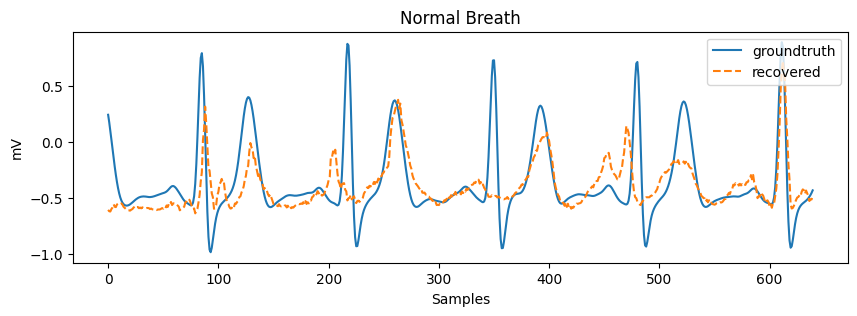

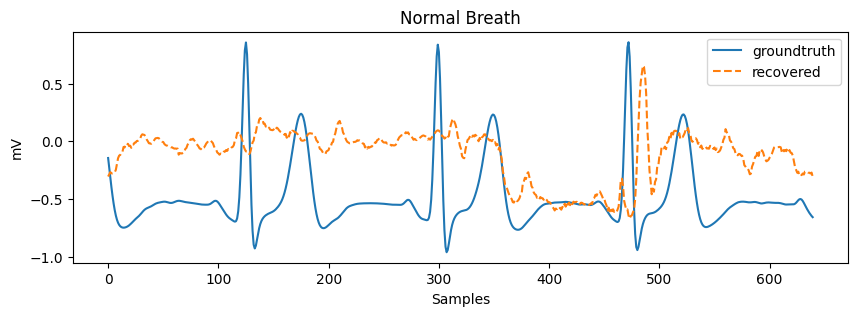

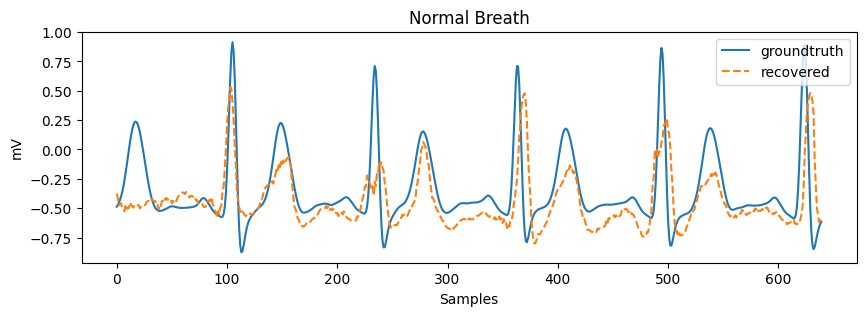

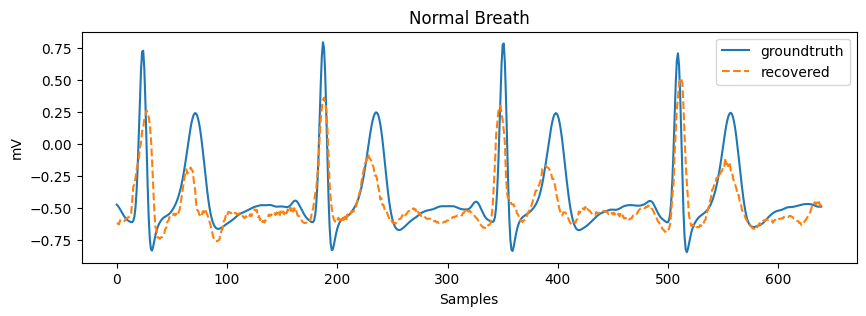

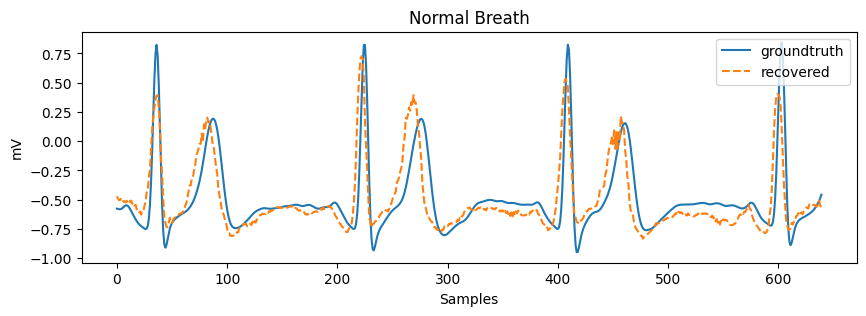

...

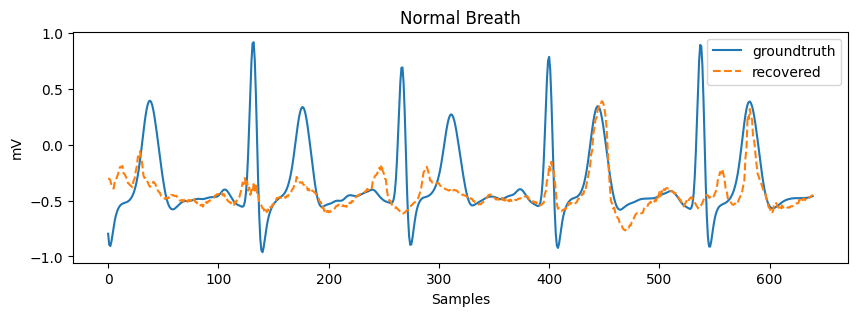

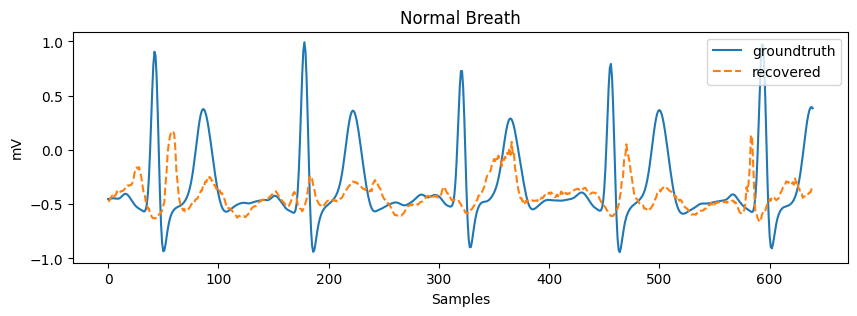

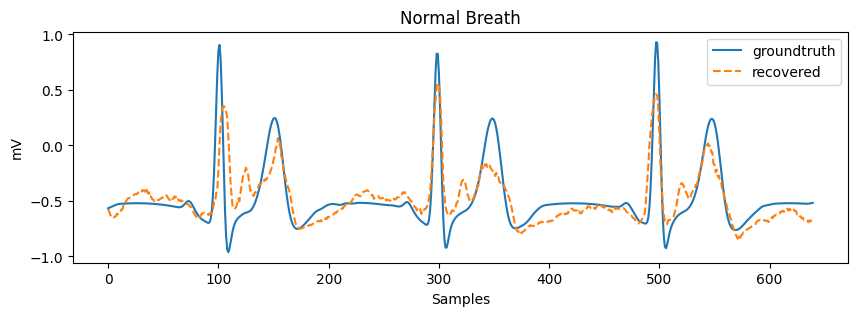

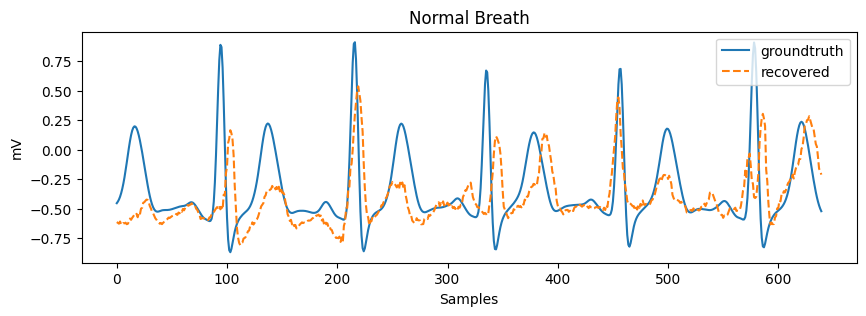

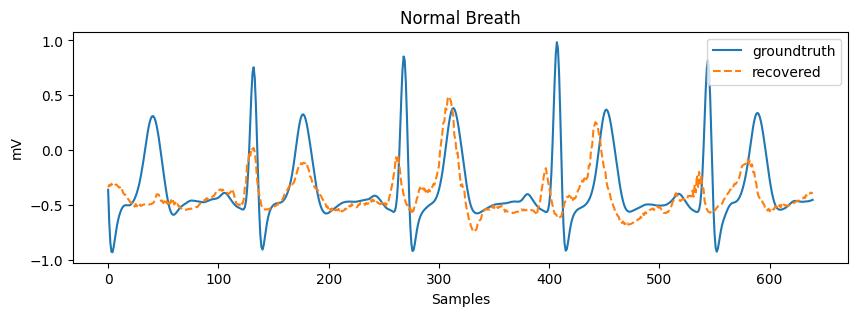

In [18]:
import matplotlib.pyplot as plt
for i in range(63):
    plt.figure(figsize=(10,3))
    plt.plot(labels[i], label = "groundtruth")
    plt.plot(outputs[i], label = "recovered", linestyle='dashed')
    plt.title(f'Normal Breath')
    plt.xlabel('Samples')
    plt.ylabel('mV')
    plt.legend(loc=1)
    plt.show()
# plt.figure(figsize=(10,3))
# plt.plot(labels[1], label = "groundtruth")
# plt.plot(outputs[1], label = "recovered", linestyle='dashed')
# plt.title(f'Normal Breath Loss: {accumulate_loss / (i+1):.4f}')
# plt.xlabel('Samples')
# plt.ylabel('mV')
# plt.legend(loc=1)
# plt.show()